# **Analysis of the Faster RCNN model for grape detection**

## Author: Pol Simon Campreciós

### **General information**

This notebook allows to perform tracking with the YOLOv5 detector (trained on an apple dataset, private for the time being) together with the deepSORT tracker

## **Notebook & environment setup**

In [ ]:
# Run this cell only if you intend to work with the data stored in Google Drive
from google.colab import drive
drive.mount("/content/drive")

In [1]:
!git clone https://github.com/psimoncam/Fruit-Detection-and-Tracking
%cd Fruit-Detection-and-Tracking

Cloning into 'Fruit-Detection-and-Tracking'...
remote: Enumerating objects: 181, done.
remote: Counting objects: 100% (40/40), done.
remote: Compressing objects: 100% (30/30), done.
remote: Total 181 (delta 12), reused 32 (delta 6), pack-reused 141
Receiving objects: 100% (181/181), 85.74 MiB | 28.40 MiB/s, done.
Resolving deltas: 100% (36/36), done.
/content/Fruit-Detection-and-Tracking


In [2]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/psimoncam/motmetrics_adaptation.git to /tmp/pip-install-uya31cjk/motmetrics_ba97fe271d204f5793f38b40aad99c4b
  Running command git clone -q https://github.com/psimoncam/motmetrics_adaptation.git /tmp/pip-install-uya31cjk/motmetrics_ba97fe271d204f5793f38b40aad99c4b
     |████████████████████████████████| 50 kB 7.4 MB/s 
  Created wheel for motmetrics: filename=motmetrics-1.2.5-py3-none-any.whl size=154331 sha256=1c14eb4ab9ed9c74d5ef492c6d9cb6d89fa8a4999f18202ffc0217b4f608f4e1
  Stored in directory: /tmp/pip-ephem-wheel-cache-wr69bmva/wheels/87/9d/19/b78bf6cfb372a1d064cea5ede61f31dec1cc2dd65061a50c6f
Successfully built motmetrics


Once we have all the libraries and scripts ready, we need to run the tracking_deepsort.py file passing as a parameter the video to be tracked.

We also pass two more parameters:



*   enlarge: To use the enlarged bounding boxes version
*   save: To save tracking results for future tracking evaluation



In [ ]:
# !python tracking_deepsort.py --enlarge --save --video path_to_video.mp4
!python tracking_deepsort.py --enlarge --save --video video1_trimmed.mp4 

Now we are going to visualize the video on Google Colab.

If it fails, you can always download the video on your local pc.

In [ ]:
from base64 import b64encode
from IPython.display import HTML

# Transcode to h264, otherwise video is not visualizing in Colab
!ffmpeg -i video1_trimmed_tracked.mp4 -an -vcodec libx264 -crf 23 video1_trimmed_tracked2.mp4

In [ ]:
# Extracted from https://stackoverflow.com/questions/57377185/how-play-mp4-video-in-google-colab
mp4 = open('video1_trimmed_tracked2.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## **Evaluation of the tracking**

To evaluate the tracking, the ground truth of the tracked video is required in order to compare the performance of the system with the original annotations.

The format of these .txt files is:

`<frame>, <id>, <bb_left>, <bb_top>, <bb_width>, <bb_height>, <conf>, <x>, <y>, <z>`

An example (https://motchallenge.net/instructions/):

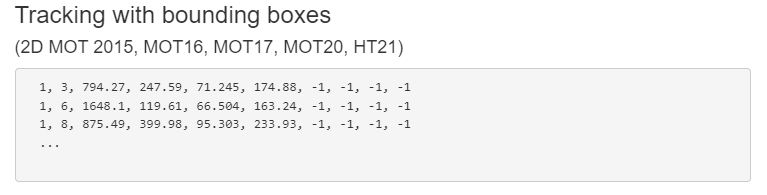

If these original annotations are available, they must be uploaded with the following structure:

```
"groundtruth_folder"
  |___video_name1
      |___gt
          |___gt.txt
  |___video_name2
      |___gt
          |___gt.txt
      ...

"results_folder"
  |___video_name1.txt
  |___video_name2.txt
```

Once all the files/folders follow the previous structure, now we need to call the eval_motchallenge.py script passing as parameters

`--groundtruths "groundtruth_folder" --tests "results_folder"`

**WARNING**: If the tracked video uses enlarged bounding boxes, the groundtruth file with the original annotations must contain also enlarged bounding boxes. Otherwise, the results will be incorrect

In [4]:
!python eval_motchallenge.py --groundtruths "./MOT/" --tests "./results/"

11:00:50 INFO - Found 1 groundtruths and 1 test files.
11:00:50 INFO - Available LAP solvers ['scipy']
11:00:50 INFO - Default LAP solver 'scipy'
11:00:50 INFO - Loading files.
11:00:51 INFO - Comparing video4...
11:00:51 INFO - Running metrics
11:00:51 INFO - partials: 0.240 seconds.
11:00:51 INFO - mergeOverall: 0.242 seconds.
         IDF1   IDP   IDR  Rcll  Prcn  GT MT PT ML  FP   FN IDs  FM  MOTA  MOTP IDt IDa IDm
video4  80.7% 87.8% 74.5% 77.2% 91.2% 129 73 39 17 336 1029  25  55 69.2% 0.190   4  18   1
OVERALL 80.7% 87.8% 74.5% 77.2% 91.2% 129 73 39 17 336 1029  25  55 69.2% 0.190   4  18   1

Information of sequence video4

ID switches [a match between a object and hypothesis was found but differs from previous assignment (hypothesisid != previous)]
4 objects with 2 ID switches
11 objects with 1 ID switches
2 objects with 3 ID switches

ID ascends [a match between a object and hypothesis was found but differs from previous assignment  (hypothesisid is new)]
10 objects with 1 ID

### **Plotting Ids per track and tracks per Id**

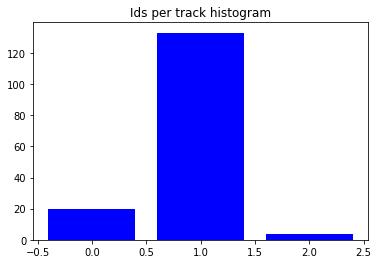

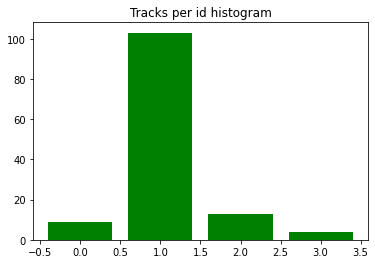

In [12]:
import matplotlib.pyplot as plt

tracks_per_id_dict = {}
ids_per_track_dict = {}

with open("ids_per_track.txt", "r") as f:
  lines = f.readlines()

for line in lines:
  line = line.strip()
  key, value = line.split(",")
  ids_per_track_dict[int(key)] = int(value)

with open("tracks_per_id.txt", "r") as f:
  lines = f.readlines()

for line in lines:
  line = line.strip()
  key, value = line.split(",")
  tracks_per_id_dict[int(key)] = int(value)

plt.bar(list(ids_per_track_dict.keys()), ids_per_track_dict.values(), color='b')
plt.title("Ids per track histogram")
plt.show()


plt.bar(list(tracks_per_id_dict.keys()), tracks_per_id_dict.values(), color='g')
plt.title("Tracks per id histogram")
plt.show()